In [12]:
import os
import cv2
import matplotlib.pyplot as plt
import pandas as pd 
import shutil
from PIL import Image 
import ultralytics
from ultralytics import YOLO


# Learning curve


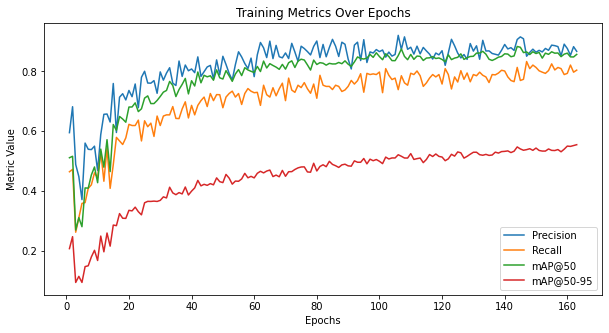

In [37]:
df = pd.read_csv("/home/long/longdata/com vis/code/runs/detect/train/results.csv")
plt.figure(figsize=(10, 5))
plt.plot(df["epoch"], df["metrics/precision(B)"], label="Precision")
plt.plot(df["epoch"], df["metrics/recall(B)"], label="Recall")
plt.plot(df["epoch"], df["metrics/mAP50(B)"], label="mAP@50")
plt.plot(df["epoch"], df["metrics/mAP50-95(B)"], label="mAP@50-95")
plt.xlabel("Epochs")
plt.ylabel("Metric Value")
plt.legend()

plt.title("Training Metrics Over Epochs")
plt.savefig("/home/long/longdata/com vis/code/plot/training_metrics_plot_v11.png")
plt.show()

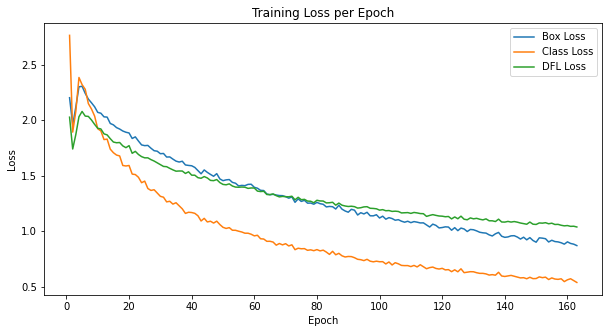

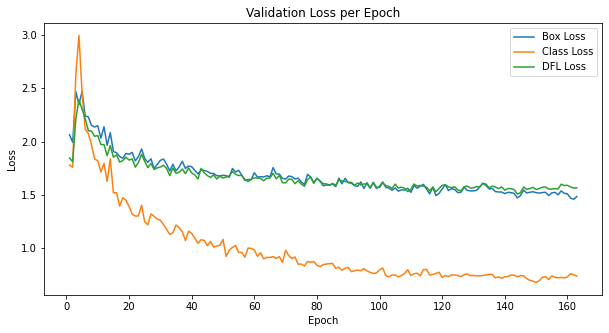

In [38]:
plt.figure(figsize=(10, 5))
plt.plot(df['epoch'], df['train/box_loss'], label='Box Loss')
plt.plot(df['epoch'], df['train/cls_loss'], label='Class Loss')
plt.plot(df['epoch'], df['train/dfl_loss'], label='DFL Loss')
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Training Loss per Epoch")
plt.legend()

plt.show()

plt.figure(figsize=(10, 5))
plt.plot(df['epoch'], df['val/box_loss'], label='Box Loss')
plt.plot(df['epoch'], df['val/cls_loss'], label='Class Loss')
plt.plot(df['epoch'], df['val/dfl_loss'], label='DFL Loss')
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Validation Loss per Epoch")
plt.legend()

plt.show()


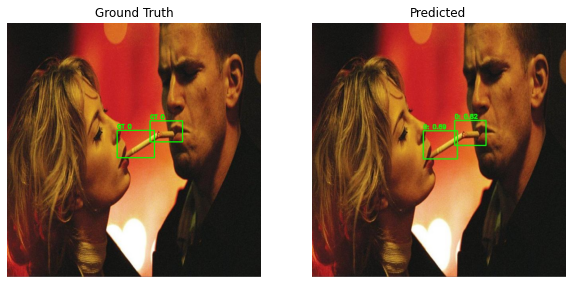

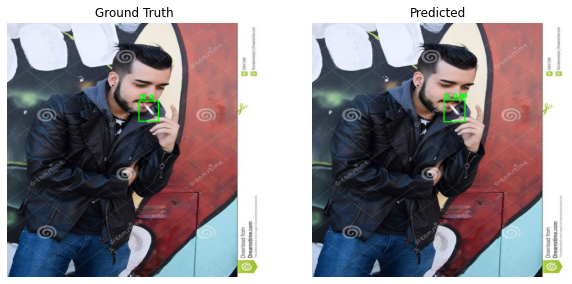

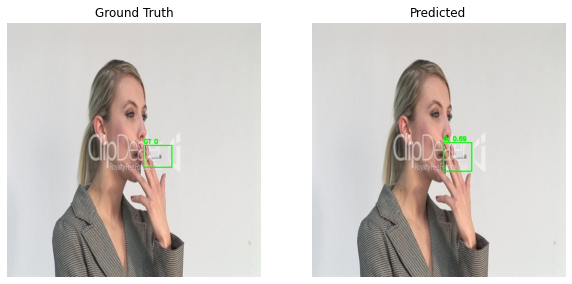

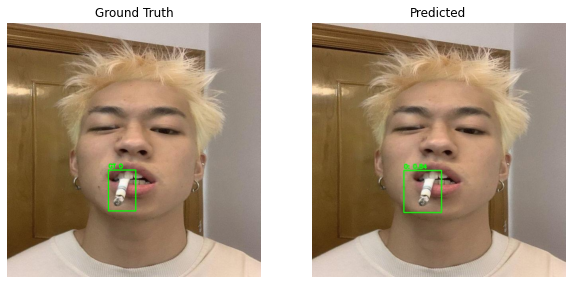

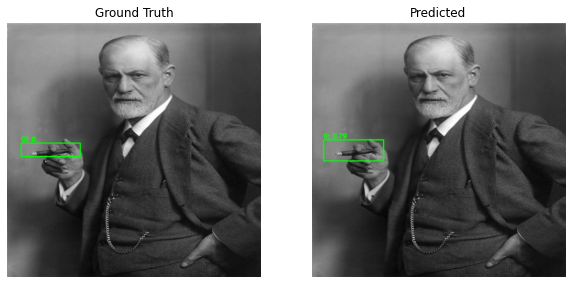

...

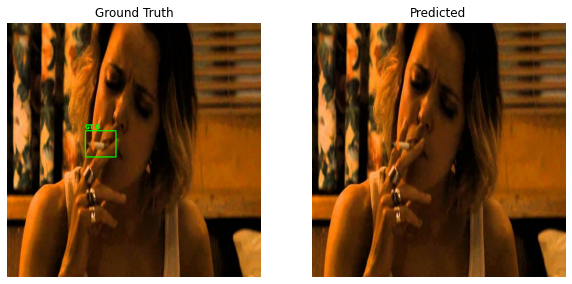

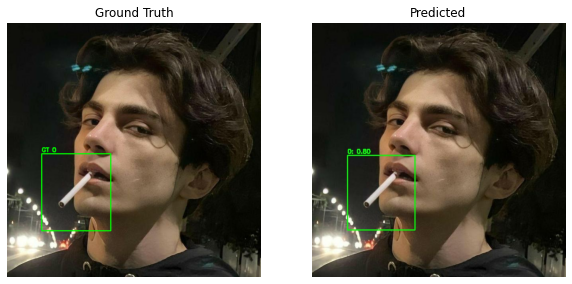

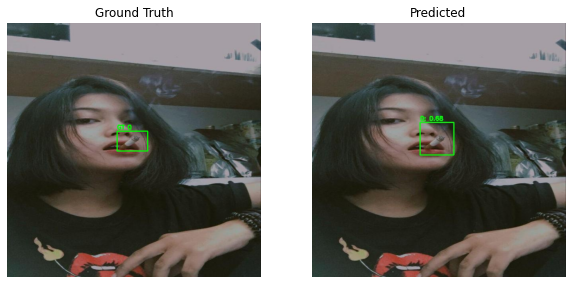

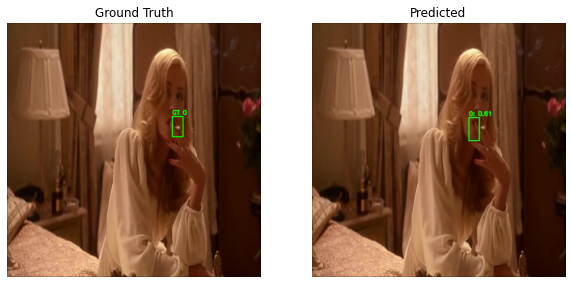

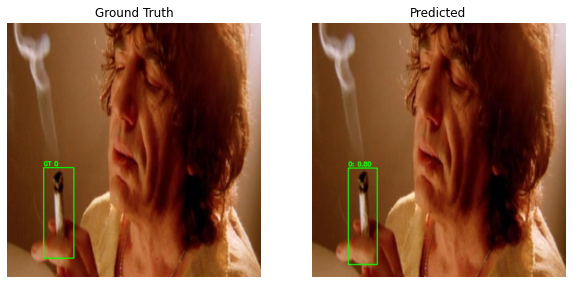

In [ ]:


def load_yolo_labels(label_path, img_width, img_height):
    boxes = []
    with open(label_path, 'r') as f:
        for line in f.readlines():
            parts = line.strip().split()
            if len(parts) < 5:
                continue  
            class_id, x_center, y_center, w, h = map(float, parts[:5])  
            x_min = int((x_center - w / 2) * img_width)
            y_min = int((y_center - h / 2) * img_height)
            x_max = int((x_center + w / 2) * img_width)
            y_max = int((y_center + h / 2) * img_height)
            boxes.append((x_min, y_min, x_max, y_max, int(class_id)))
    return boxes

def draw_bounding_boxes(image, boxes, color, label="GT"):
    for (x_min, y_min, x_max, y_max, class_id) in boxes:
        cv2.rectangle(image, (x_min, y_min), (x_max, y_max), color, 2)
        cv2.putText(image, f"{label} {class_id}", (x_min, y_min - 5),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)  
    return image

def visualize_results(predicted_folder, gt_folder, selected_images_folder):
    
    if not os.path.exists(selected_images_folder):
        print(f"Error: Folder {selected_images_folder} not found!")
        return
    
    selected_images = [f for f in os.listdir(selected_images_folder) if f.endswith(('.jpg', '.png'))]

    if not selected_images:
        print("No images found in the selected folder.")
        return

    for img_name in selected_images:
        gt_img_path = os.path.join(selected_images_folder, img_name)  
        gt_label_path = os.path.join(gt_folder, img_name.replace('.jpg', '.txt').replace('.png', '.txt'))
        pred_img_path = os.path.join(predicted_folder, img_name)

        if not os.path.exists(gt_img_path) or not os.path.exists(gt_label_path) or not os.path.exists(pred_img_path):
            print(f"Skipping {img_name}, missing files.")
            continue

        original_img = cv2.imread(gt_img_path)
        if original_img is None:
            print(f"Error loading image: {img_name}")
            continue

        original_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)
        img_height, img_width, _ = original_img.shape

     
        gt_boxes = load_yolo_labels(gt_label_path, img_width, img_height)
        gt_img = original_img.copy()  
        gt_img = draw_bounding_boxes(gt_img, gt_boxes, (0, 255, 0), label="GT")  


        pred_img = cv2.imread(pred_img_path)
        pred_img = cv2.cvtColor(pred_img, cv2.COLOR_BGR2RGB)

       
        fig, ax = plt.subplots(1, 2, figsize=(10, 5))
        ax[0].imshow(gt_img)
        ax[0].set_title("Ground Truth")
        ax[0].axis("off")

        ax[1].imshow(pred_img)
        ax[1].set_title("Predicted")
        ax[1].axis("off")

        plt.show()

predicted_folder = "/home/long/longdata/com vis/sahi predicted/visualized_k aug moi"
gt_folder = "/home/long/longdata/com vis/data/k aug/test/labels"
false_positive_folder = "error_analysis/false_positives"  

visualize_results(predicted_folder, gt_folder, false_positive_folder)


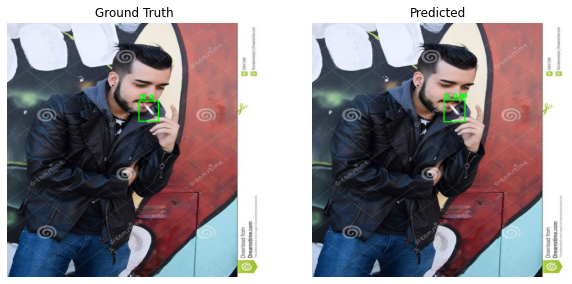

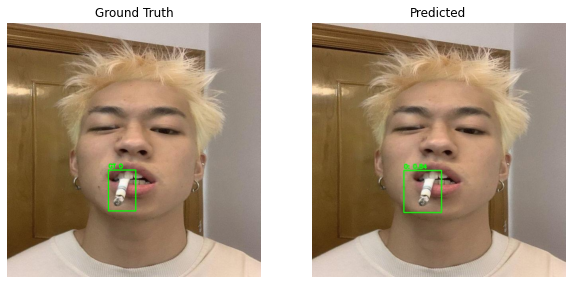

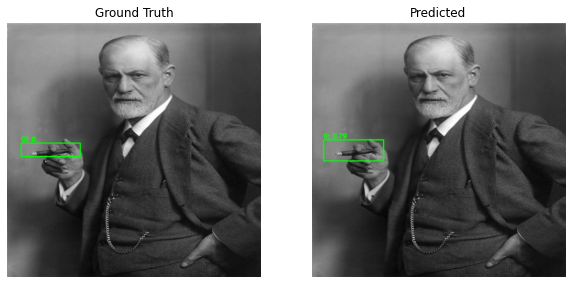

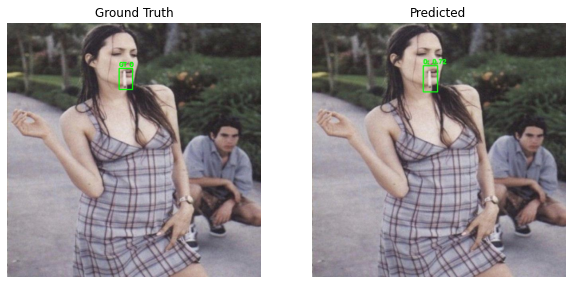

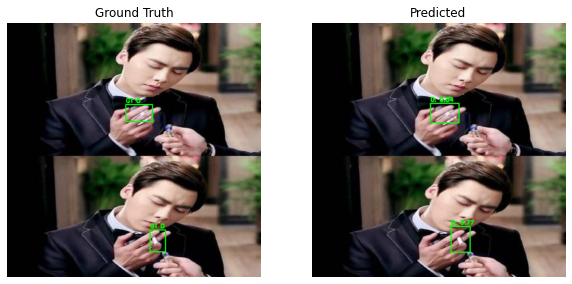

...

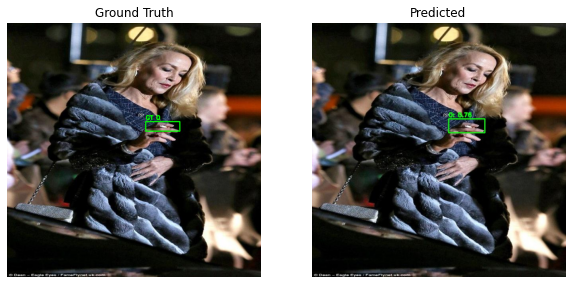

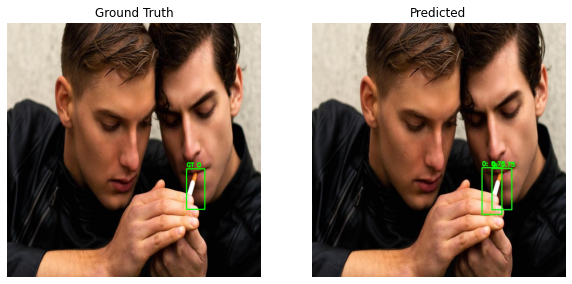

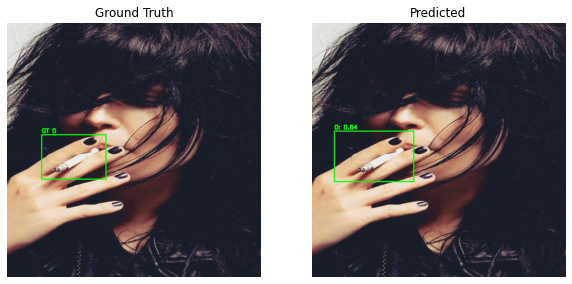

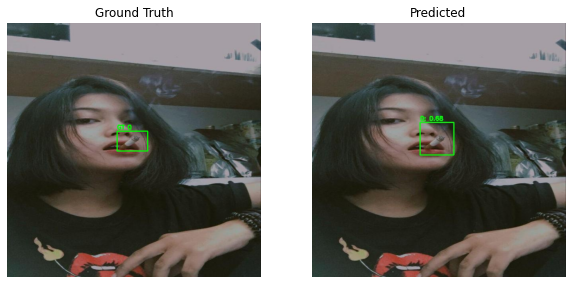

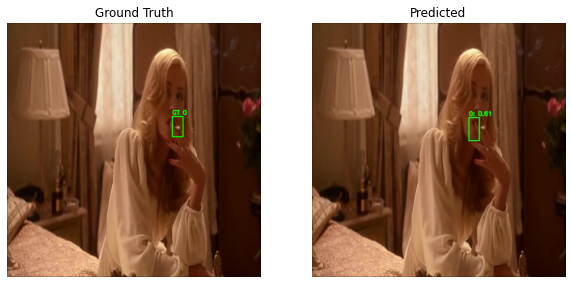

In [28]:
false_negative_folder = "error_analysis/false_negatives"  
visualize_results(predicted_folder, gt_folder, false_negative_folder)


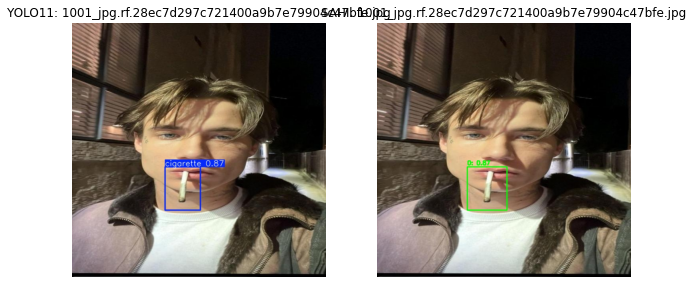

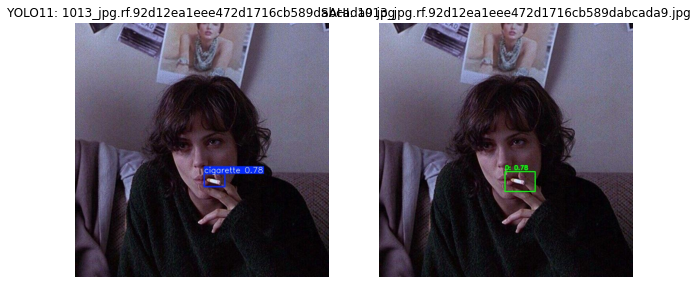

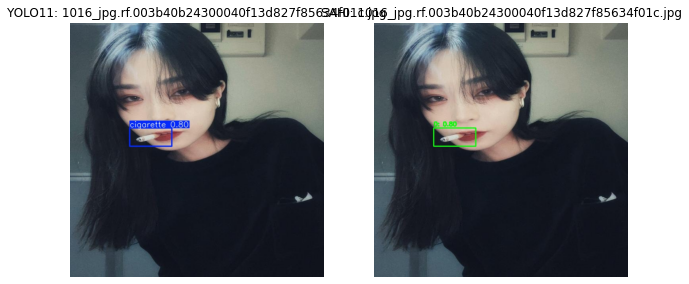

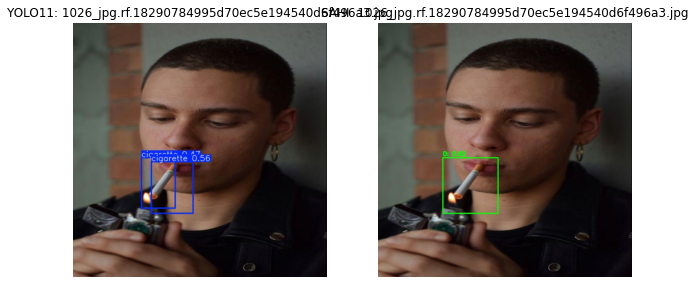

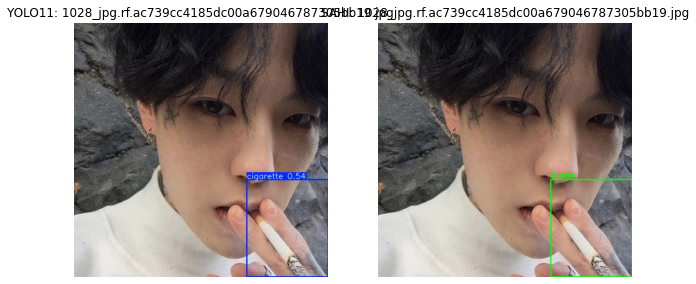

...

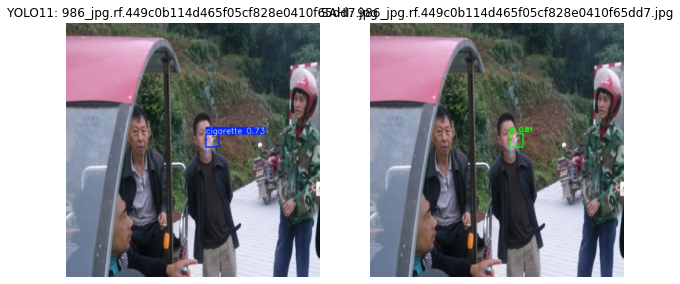

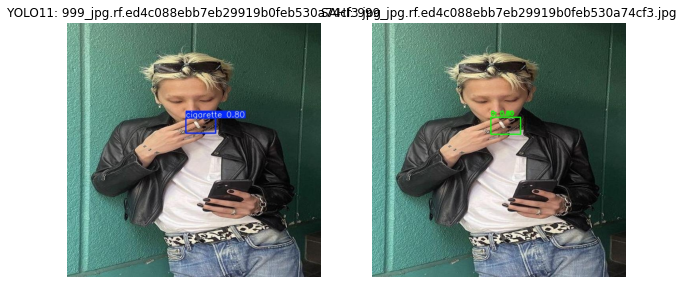

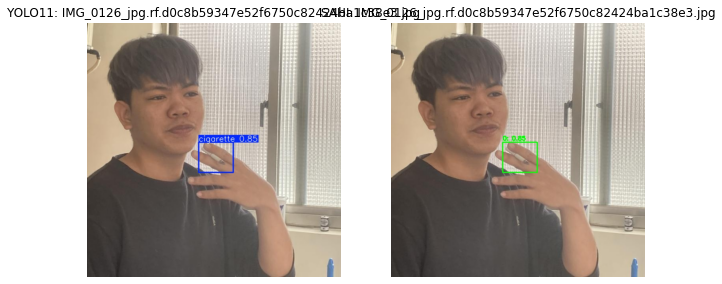

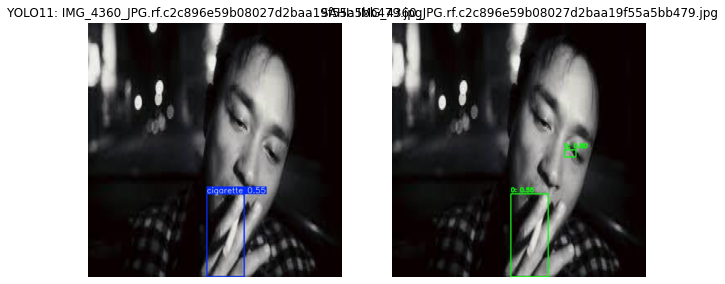

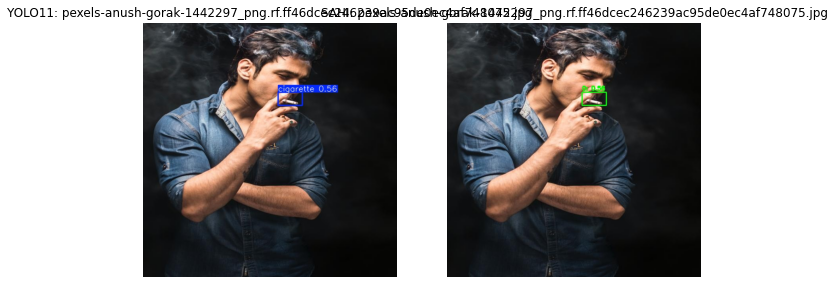

In [40]:
import os
import cv2
import matplotlib.pyplot as plt

def load_images_from_folder(folder):
    images = {}
    for filename in sorted(os.listdir(folder)):
        if filename.lower().endswith(('png', 'jpg', 'jpeg')):
            img_path = os.path.join(folder, filename)
            img = cv2.imread(img_path)
            if img is not None:
                img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                images[filename] = img
    return images

def visualize_predictions(folder1, folder2):
    images1 = load_images_from_folder(folder1)
    images2 = load_images_from_folder(folder2)
    
    common_filenames = sorted(set(images1.keys()) & set(images2.keys()))
    
    for filename in common_filenames:
        fig, axes = plt.subplots(1, 2, figsize=(10, 5))
        
        axes[0].imshow(images1[filename])
        axes[0].set_title(f"YOLO11: {filename}")
        axes[0].axis("off")
        
        axes[1].imshow(images2[filename])
        axes[1].set_title(f"SAHI: {filename}")
        axes[1].axis("off")
        
        plt.show()

folder1 = "/home/long/longdata/com vis/code/runs/detect/predict"
folder2 = "/home/long/longdata/com vis/sahi predicted/visualized_k aug moi"
visualize_predictions(folder1, folder2)